<h1>Содержание<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#Задание-начальных-параметров" data-toc-modified-id="Задание-начальных-параметров-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>Задание начальных параметров</a></span></li><li><span><a href="#Задание-приемников" data-toc-modified-id="Задание-приемников-2"><span class="toc-item-num">2&nbsp;&nbsp;</span>Задание приемников</a></span></li><li><span><a href="#Задание-источников" data-toc-modified-id="Задание-источников-3"><span class="toc-item-num">3&nbsp;&nbsp;</span>Задание источников</a></span></li><li><span><a href="#Построение-изображения-модели-среды" data-toc-modified-id="Построение-изображения-модели-среды-4"><span class="toc-item-num">4&nbsp;&nbsp;</span>Построение изображения модели среды</a></span></li><li><span><a href="#Задание-сигнала" data-toc-modified-id="Задание-сигнала-5"><span class="toc-item-num">5&nbsp;&nbsp;</span>Задание сигнала</a></span></li><li><span><a href="#Проверка-условий" data-toc-modified-id="Проверка-условий-6"><span class="toc-item-num">6&nbsp;&nbsp;</span>Проверка условий</a></span></li><li><span><a href="#Задание-параметров-снэпшота" data-toc-modified-id="Задание-параметров-снэпшота-7"><span class="toc-item-num">7&nbsp;&nbsp;</span>Задание параметров снэпшота</a></span></li><li><span><a href="#Моделирование-прямого-прохождения-волны" data-toc-modified-id="Моделирование-прямого-прохождения-волны-8"><span class="toc-item-num">8&nbsp;&nbsp;</span>Моделирование прямого прохождения волны</a></span></li><li><span><a href="#Мьютинг" data-toc-modified-id="Мьютинг-9"><span class="toc-item-num">9&nbsp;&nbsp;</span>Мьютинг</a></span></li><li><span><a href="#Построение-измеренного-на-приемниках-временного-разреза" data-toc-modified-id="Построение-измеренного-на-приемниках-временного-разреза-10"><span class="toc-item-num">10&nbsp;&nbsp;</span>Построение измеренного на приемниках временного разреза</a></span></li><li><span><a href="#Применение-различных-методов-миграции" data-toc-modified-id="Применение-различных-методов-миграции-11"><span class="toc-item-num">11&nbsp;&nbsp;</span>Применение различных методов миграции</a></span><ul class="toc-item"><li><span><a href="#Revers" data-toc-modified-id="Revers-11.1"><span class="toc-item-num">11.1&nbsp;&nbsp;</span>Revers</a></span></li><li><span><a href="#Summing" data-toc-modified-id="Summing-11.2"><span class="toc-item-num">11.2&nbsp;&nbsp;</span>Summing</a></span></li><li><span><a href="#Smearing" data-toc-modified-id="Smearing-11.3"><span class="toc-item-num">11.3&nbsp;&nbsp;</span>Smearing</a></span></li></ul></li><li><span><a href="#Вывод" data-toc-modified-id="Вывод-12"><span class="toc-item-num">12&nbsp;&nbsp;</span>Вывод</a></span></li></ul></div>

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import numpy as np                
import pylab as plt
import numpy.matlib as nmp
import matplotlib.animation as animation
from IPython.display import Image, display
from tqdm import tqdm

import lib_propag as afd
import lib_plot as afdpl

## Задание начальных параметров 

* Z - глубина в м
* X - расстояние по оси x в м
* T - время в мс
* VEL - скорость в км/ч

In [3]:
T0 = 0; Tend = 600; dt = 0.5
X0 = -1500; Xend = 1500; dx = 5
Z0 = 0; Zend = 1200; dz = 5

X = np.arange(X0, Xend, dx); nx = len(X); ox = X[0]
Z = np.arange(Z0, Zend, dz); nz = len(Z); oz = Z[0]

In [4]:
VEL = 3
v = np.ones((nz, nx), 'f') * VEL

## Задание приемников

r - линия приемников

In [5]:
r1 = -600; r2 = 600; dr = 10
r = np.arange(r1, r2, dr); nr = len(r)
zr = np.zeros((2, nr), 'f')
zr[:][0] = r[:]
zr[:][1] = 20

## Задание источников

k - линия источников

Для корректной работы зададим функцию округления до заданного базиса

In [6]:
def myround(x, base=5):
    return base * round(x / base)

Задаем наклонное расположение линии источников

In [7]:
k1 = -1000; k2 = 1000; dk = 5
k = np.arange(k1, k2, dk); nk = len(k)
zk = np.zeros((2, nk), 'f')
zk[:][0]= k[:]
zk[:][1]= 0.16 * k + 490

for i in range(len(zk[:][1])):
    zk[1][i] = myround(zk[1][i], base=5)

## Построение изображения модели среды

Получаем начальные параметры сейсмического изображения

In [8]:
idx_s, idx_r, idz_s, idz_r, xs, zs, xr, zr = afd.initial_grid_parameters(zr, zk, X0, Z0, dx, dz, X, Z)
t, itime = afd.initial_time_parameters(Tend, dt)

Строим заданную модель

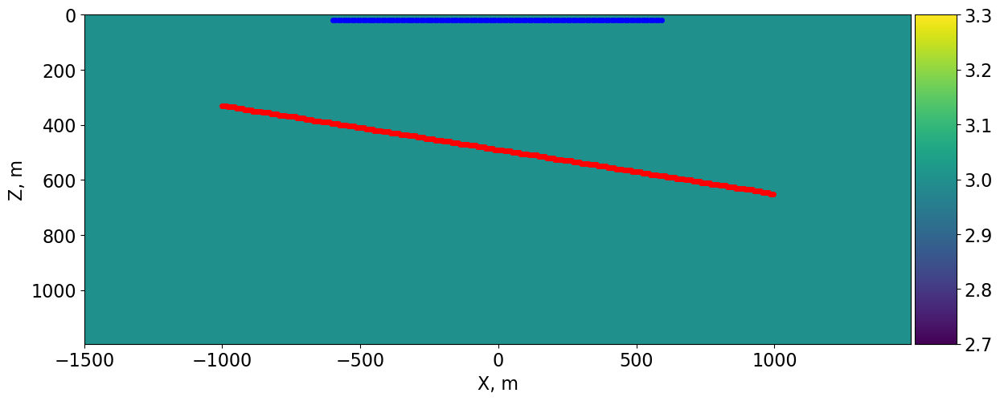

In [9]:
afdpl.plot_model(X, Z, xr, zr, xs, zs, v, lsize=16, msize=8, xsize=14, zsize=7)

## Задание сигнала

Смоделируем импульс Рикера - нуль-фазовый сигнал с центральным пиком

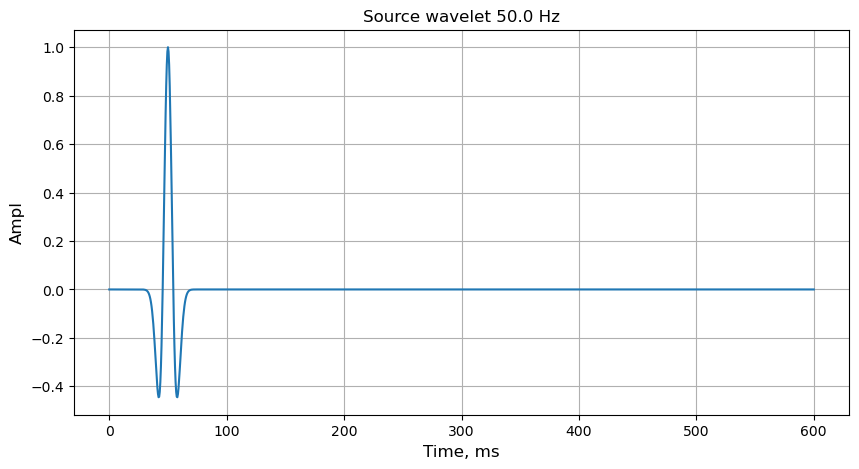

In [10]:
hz = 0.05
rick = afd.ricker(hz, t, 50)
afdpl.plot_ricker(rick, t, lsize=12, xsize=10, zsize=5, hz=hz * 1000)

## Проверка условий

Проведем проверку на устойчивость условий

In [11]:
afd.check_conditions(v, dx, dz, dt, hz)

condition stability +
condition dispersion +


## Задание параметров снэпшота

In [12]:
sTime = 0
endTime = t[-1]
dst = 5
isnap = afd.initial_snapshot_parameters(sTime, endTime, dt, dst)

In [13]:
Par_init = {'dx': dx,'dz': dz,'dt': dt,'ind_sou': [idz_s, idx_s],'itime': itime, 
         'wavelet': nmp.repmat(rick, np.size(idx_s), 1), 'isnap': isnap, 'ind_rec': [idz_r, idx_r]}
memSize = 4000

## Моделирование прямого прохождения волны

In [14]:
outdata, outsnap = afd.afd_propagate(v / 2, Par_init, memSize)

100%|██████████| 1201/1201 [00:03<00:00, 318.34it/s]


## Мьютинг

Эмпирическим путем выбираем, как лучше всего обрезать сигнал

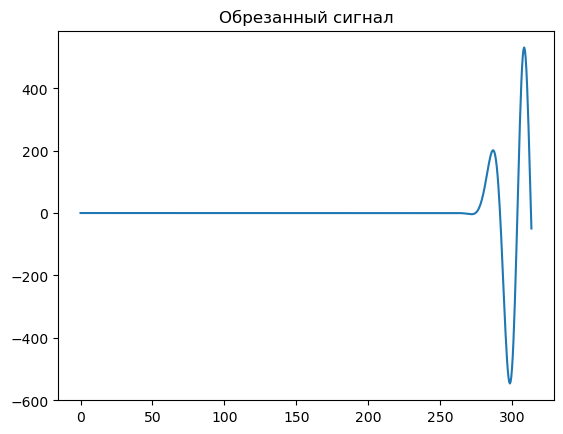

In [15]:
plt.plot(t[:628], outdata[0, :628])
plt.title('Обрезанный сигнал');

In [16]:
a = (754 - 627) / 59
b = (60 * 627 - 754) / 59
for i in range(120):
    outdata[i, int(a * i + b):] = 0

## Построение измеренного на приемниках временного разреза

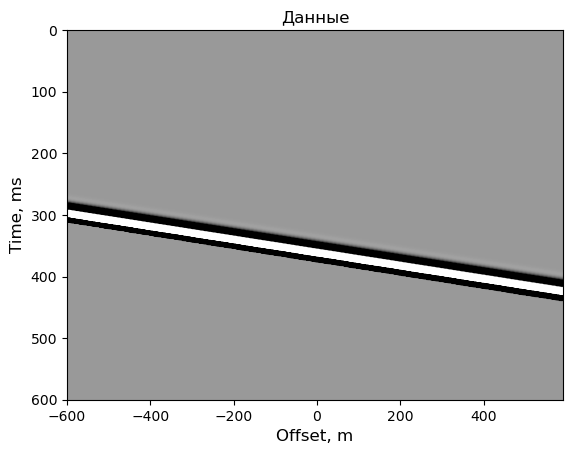

<Figure size 2500x1500 with 0 Axes>

In [17]:
fig, axs = plt.subplots()
afdpl.scalable_imshow(
    outdata.T,
    1,
    t,
    axs=axs,
    offset=xr,
    lsize=12,
    xsize=25,
    zsize=15,
    norm='on',
    ratio='auto',
    color_map='Greys',
    title='Данные'
)

In [18]:
afdpl.snapshot_animation1(outsnap, X, Z, lsize=10, dpi=150, name='Model_test', line_r=True,
                          xr=xs, zr=zs, line_s=True , xs=xr, zs=zr);

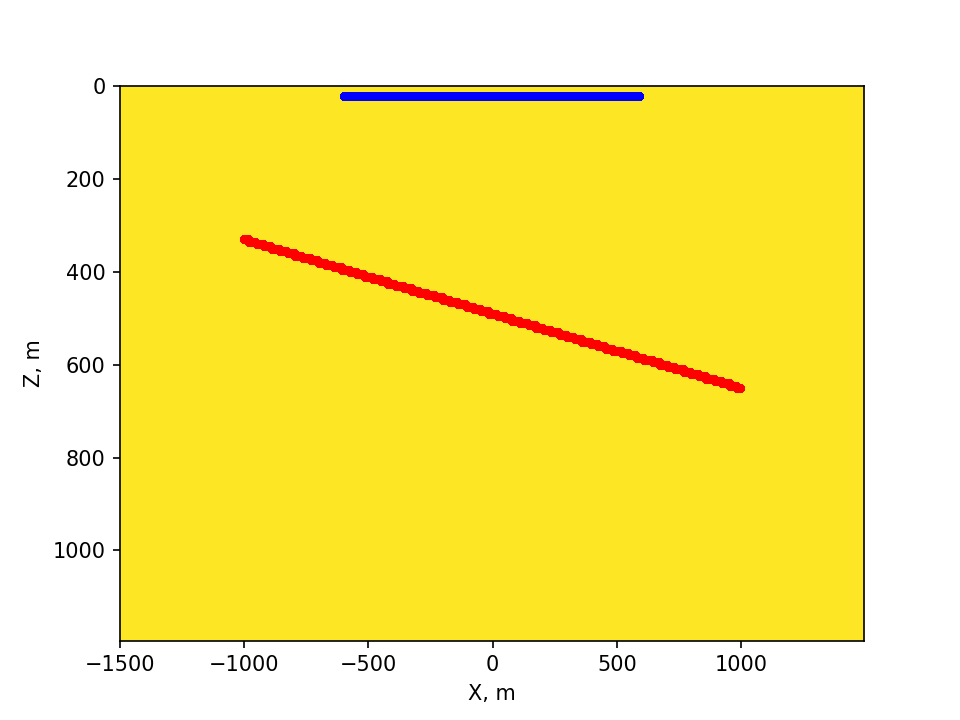

In [19]:
with open('Model_test.gif','rb') as file:
    display(Image(file.read(), width=600, height=300))

## Применение различных методов миграции

### Revers

In [20]:
outdata_rev = outdata.copy()
outdata_rev = np.flip(outdata_rev , axis=1)

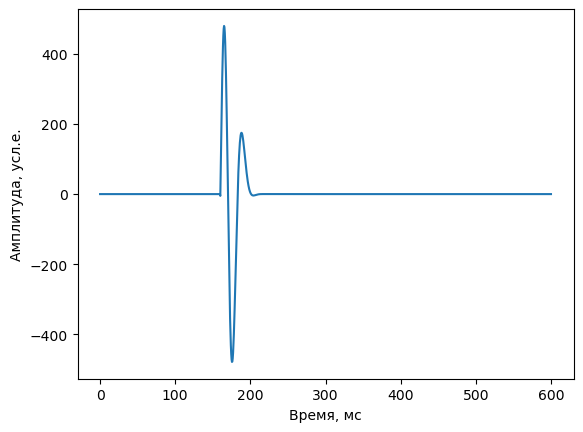

In [21]:
plt.plot(t, outdata_rev[119, :]);
ax = plt.gca()
ax.set_xlabel('Время, мс')
ax.set_ylabel('Амплитуда, усл.е.');

In [22]:
sTime = 0
endTime = t[-1]
dst = 5
isnap = afd.initial_snapshot_parameters(sTime, endTime, dt, dst)

Par_rev = {'dx': dx, 'dz': dz, 'dt': dt, 'ind_sou': [idz_r, idx_r], 'itime': itime, 
           'wavelet': outdata_rev, 'isnap': isnap, 'ind_rec': [idz_r, idx_r]}

In [23]:
outdata_rev_result, outsnap_rev_result = afd.afd_propagate(v / 2,Par_rev, memSize)

100%|██████████| 1201/1201 [00:03<00:00, 346.62it/s]


In [24]:
afdpl.snapshot_animation1(outsnap_rev_result, X, Z, lsize=12, dpi=150, name='Model_test_rev',
                          line_r=True, line_s= True, xr=xr, zr=zr, xs=xs, zs=zs)

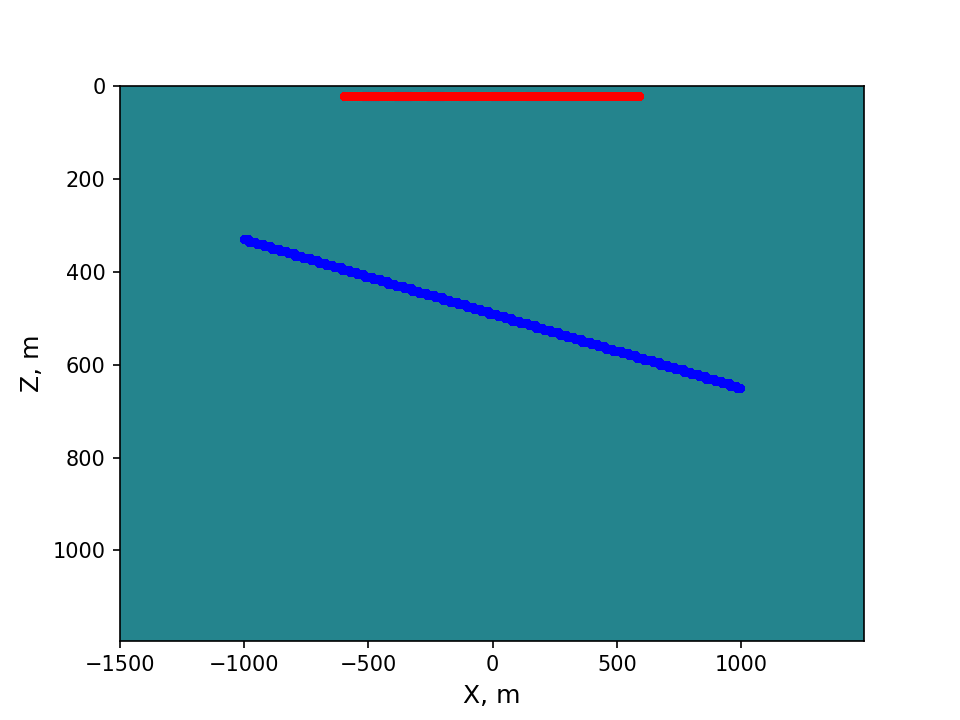

In [25]:
with open('Model_test_rev.gif','rb') as file:
    display(Image(file.read(), width=600, height=300))

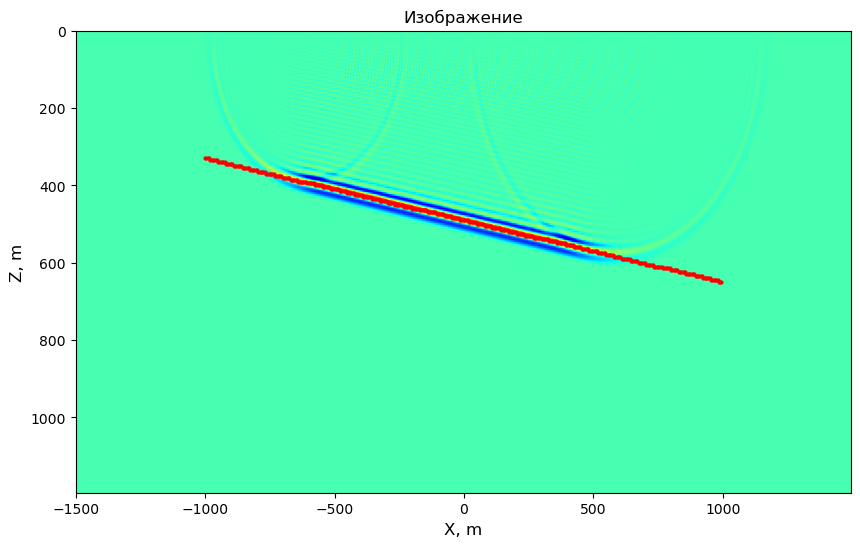

<Figure size 2500x1500 with 0 Axes>

In [26]:
fig, ax = plt.subplots(figsize=(10, 6))
ax = afdpl.scalable_imshow_2(
    outsnap_rev_result[:, :, 109],
    0.1,
    Z,
    axs=ax,
    X=X,
    lsize=12,
    xsize=25,
    zsize=15,
    norm='off',
    ratio='auto',
    color_map='jet',
    title='Изображение',
    xg=xs,
    zg=zs,
    msize=4
)

### Summing

In [27]:
outsnap_sum = np.zeros((outsnap.shape[0], outsnap.shape[1]))

for i in tqdm(range(outsnap_sum.shape[0])):
    for j in range(outsnap_sum.shape[1]):
        for k in range(len(xr)):
            distantion = np.sqrt((X[j] - xr[k]) ** 2 + (Z[i] - zr[k]) ** 2)
            time = 2 * distantion / VEL
            indx = time // dt + 100
            if int(indx) <= len(t) - 1:
                outsnap_sum[i, j] += outdata[k, int(indx)]

100%|██████████| 240/240 [01:44<00:00,  2.29it/s]


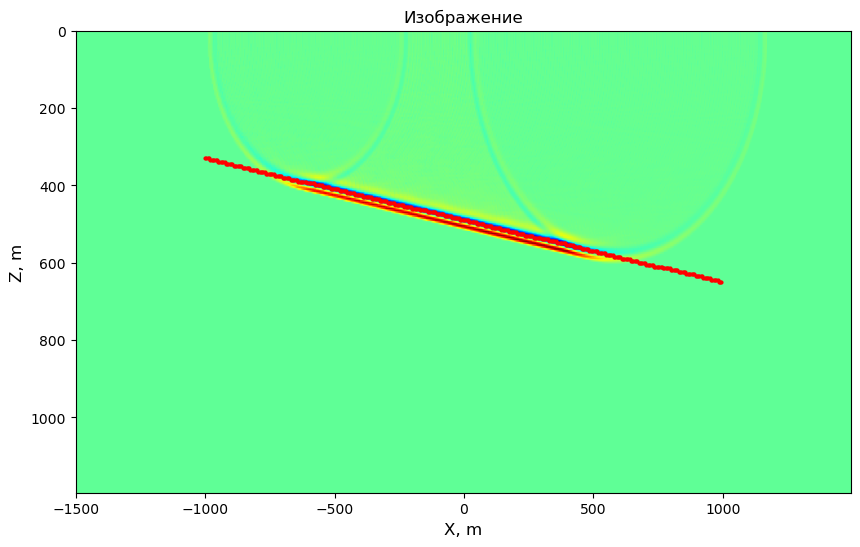

<Figure size 2500x1500 with 0 Axes>

In [28]:
fig, ax = plt.subplots(figsize=(10, 6))
ax = afdpl.scalable_imshow_2(
    outsnap_sum,
    0.1,
    Z,
    axs=ax,
    X=X,
    lsize=12,
    xsize=25,
    zsize=15,
    norm='off',
    ratio='auto',
    color_map='jet',
    title='Изображение',
    xg=xs,
    zg=zs,
    msize=4
)

### Smearing

In [29]:
def circle(x, y, t_shift, vel, dx):
    all_indx = []
    ind_r = int(vel * t_shift // dx)
    for i in range(x - ind_r, x + ind_r + 1, 1):
        for j in range(y - ind_r, y + ind_r + 1, 1):
            distance = np.sqrt ((x - i) ** 2 + (y - j) **2) 
            if distance  <= ind_r + 0.5 and distance >= ind_r - 0.5:
                all_indx.append([i, j])
    return np.array(all_indx), int(ind_r)

In [30]:
bubbles = []
for i in tqdm(range(len(t) - 100)):
    indx, r = circle(0, 0 , t[i], VEL / 2, dx)
    bubbles.append(indx)

100%|██████████| 1101/1101 [01:45<00:00, 10.45it/s]


In [31]:
outsnap_smear = np.zeros((outsnap.shape[0], outsnap.shape[1]))
for i in tqdm(range(len(t) - 100)):
    a = bubbles[i]
    for n in range(len(xr)):
        for k in range(len(a)):
            if zr[n] // dz + a[k][0] < outsnap.shape[0] and zr[n] // dz + a[k][0] >= 0:
                if abs(X0 - xr[n]) // dx + a[k][1] < outsnap.shape[1] and abs(X0 - xr[n]) // dx + a[k][1] >= 0:
                    outsnap_smear[zr[n] // dz + a[k][0], abs(X0 - xr[n]) // dx + a[k][1]] += outdata[n, i + 100]

100%|██████████| 1101/1101 [06:57<00:00,  2.64it/s]


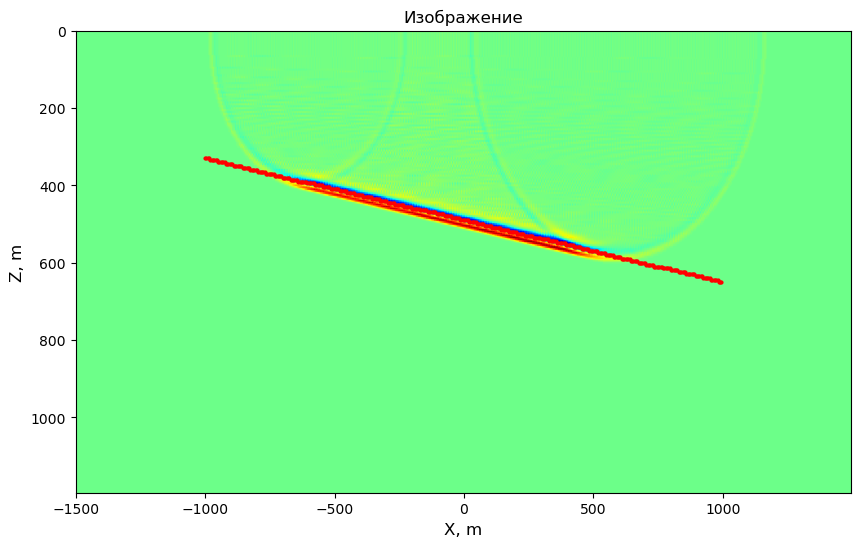

<Figure size 2500x1500 with 0 Axes>

In [32]:
fig, ax = plt.subplots(figsize=(10, 6))
ax = afdpl.scalable_imshow_2(
    outsnap_smear,
    0.1,
    Z,
    axs=ax,
    X=X,
    lsize=12,
    xsize=25,
    zsize=15,
    norm='off',
    ratio='auto',
    color_map='jet',
    title='Изображение',
    xg=xs,
    zg=zs,
    msize=4
)

## Вывод

Всеми 3 способами миграции удалось получить одинаковый глубинный разрез в однородной изотропной среде. То есть, по сейсмической записи на приемниках мы восстановили положение источников.